
# Plane Object Detection, Semantic Segmentation, and Instance Segmentation


## Install dependencies and initialization

In [ ]:
import os
p = os.getenv('PATH')
ld = os.getenv('LD_LIBRARY_PATH')
os.environ['PATH'] = f"/usr/local/cuda-11.1/bin:{p}"
os.environ['LD_LIBRARY_PATH'] = f"/usr/local/cuda-11.1/lib64:{ld}"
!pip install torch torchvision torchaudio

In [ ]:
!python -m pip install pyyaml==5.1
import sys, os, distutils.core
# Note: This is a faster way to install detectron2 in Colab, but it does not include all functionalities (e.g. compiled operators).
# See https://detectron2.readthedocs.io/tutorials/install.html for full installation instructions
!git clone 'https://github.com/facebookresearch/detectron2'
dist = distutils.core.run_setup("./detectron2/setup.py")
!python -m pip install {' '.join([f"'{x}'" for x in dist.install_requires])}
sys.path.insert(0, os.path.abspath('./detectron2'))

  Using cached PyYAML-5.1.tar.gz (274 kB)
  error: subprocess-exited-with-error
  
  × python setup.py egg_info did not run successfully.
  │ exit code: 1
  ╰─> See above for output.
  
  note: This error originates from a subprocess, and is likely not a problem with pip.
  Preparing metadata (setup.py) ... error
error: metadata-generation-failed

× Encountered error while generating package metadata.
╰─> See above for output.

note: This is an issue with the package mentioned above, not pip.
hint: See above for details.
Cloning into 'detectron2'...
remote: Enumerating objects: 15280, done.
remote: Counting objects: 100% (5/5), done.
remote: Compressing objects: 100% (5/5), done.
remote: Total 15280 (delta 0), reused 1 (delta 0), pack-reused 15275
Receiving objects: 100% (15280/15280), 6.18 MiB | 11.31 MiB/s, done.
Resolving deltas: 100% (11114/11114), done.
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 50.2/50.2 kB 2.9 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━

In [ ]:
!pwd # shows current directory
!ls  # shows all files in this directory
!nvidia-smi # shows the specs and the current status of the allocated GPU

/content
'=2.0.1'   detectron2   sample_data
Fri Nov 10 18:00:40 2023       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 525.105.17   Driver Version: 525.105.17   CUDA Version: 12.0     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla T4            Off  | 00000000:00:04.0 Off |                    0 |
| N/A   40C    P8     9W /  70W |      3MiB / 15360MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                           

In [ ]:
# import some common libraries
from google.colab.patches import cv2_imshow
from sklearn.metrics import jaccard_score
from PIL import Image, ImageDraw
from tqdm.notebook import tqdm
import pandas as pd
import numpy as np
import datetime
import random
import json
import cv2
import csv
import os

# import some common pytorch utilities
from torch.utils.data import Dataset, DataLoader
import torchvision.transforms as transforms
from torch.autograd import Variable
import torch.nn.functional as F
import torch.nn as nn
import torch

# import some common detectron2 utilities
import detectron2
from detectron2 import model_zoo
from detectron2.config import get_cfg
from detectron2.structures import BoxMode
from detectron2.engine import DefaultTrainer
from detectron2.engine import DefaultPredictor
from detectron2.utils.logger import setup_logger
from detectron2.utils.visualizer import ColorMode
from detectron2.utils.visualizer import Visualizer
from detectron2.data import build_detection_test_loader
from detectron2.data import MetadataCatalog, DatasetCatalog
from detectron2.evaluation import COCOEvaluator, inference_on_dataset
setup_logger()

<Logger detectron2 (DEBUG)>

In [ ]:
# Make sure that GPU is available for your notebook.
# Otherwise, you need to update the settungs in Runtime -> Change runtime type -> Hardware accelerator
torch.cuda.is_available()

True

In [ ]:
from google.colab import drive
drive._mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
BASE_DIR = '/content/drive/My Drive/CMPT_CV_lab3'
OUTPUT_DIR = '{}/output'.format(BASE_DIR)
os.makedirs(OUTPUT_DIR, exist_ok=True)

## Part 1: Object Detection

## Data Loader

Split Train dataset into 90/10 Train data and Valid data

In [ ]:
def train(val_size = 0):
  data_dirs = '{}/data/train.json'.format(BASE_DIR)
  print(data_dirs)
  with open(BASE_DIR) as i:
    print(BASE_DIR)
  with open(data_dirs) as j:
      imgs_anns = json.load(j)

  dataset_dicts={}

  for index, v in enumerate(tqdm(imgs_anns)):
      filename = os.path.join(f'{BASE_DIR}/data/train', v["file_name"])
      print(filename)
      annotations = v["segmentation"]
      px = [annotations[0][i] for i in range(0, len(annotations[0]), 2)]
      py = [annotations[0][i] for i in range(1, len(annotations[0]), 2)]
      poly = [(x + 0.5, y + 0.5) for x, y in zip(px, py)]
      poly = [p for x in poly for p in x]
      obj = {
          "bbox": [np.min(px), np.min(py), np.max(px), np.max(py)],
          "bbox_mode": BoxMode.XYXY_ABS,
          "segmentation": [poly],
          "category_id": 0,
      }
      if not filename in dataset_dicts:
          width, height = Image.open(filename).size
          dataset_dicts[filename] = {}
          dataset_dicts[filename]['annotations'] = []
          dataset_dicts[filename]['file_name'] = filename
          dataset_dicts[filename]['image_id'] = index
          dataset_dicts[filename]['height'] = int(height)
          dataset_dicts[filename]['width'] = int(width)
      dataset_dicts[filename]['annotations'].append(obj)
  dataset_dicts = np.array(list(dataset_dicts.values()))
  valid_set = np.random.choice(dataset_dicts.shape[0], val_size)
  return dataset_dicts, valid_set

In [ ]:
'''
# This function should return a list of data samples in which each sample is a dictionary.
# Select the correct bbox_mode for the data
# For the test data, only have access to the images, therefore, the annotations should be empty.
# Other values could be obtained from the image files.
'''

dataset, vals = train(0)
valid_dataset_dic, vals2 = train(35)

def get_detection_data(set_name):
  if set_name == 'valid.json':
    # print(len(dataset[vals2]))
    return dataset[vals2].tolist()

  if set_name == 'test.json':
      dataset_dicts = []
      for f in tqdm(glob(f'{BASE_DIR}/data/test/*')):
          entry = {}
          width, height = Image.open(f).size
          entry['file_name'] = f
          entry['height'] = int(height)
          entry['width'] = int(width)
          entry['annotations'] = []
          dataset_dicts.append(entry)
      return dataset_dicts
  else:
    train_dataset = np.delete(dataset, vals)
    # print(len(train_dataset))
    return train_dataset.tolist()

/content/drive/My Drive/Colab Notebooks/03-cnn-detection-segmentation/data/train.json


IsADirectoryError: ignored

In [ ]:
'''
# Remember to add your dataset to DatasetCatalog and MetadataCatalog
# Consdier "data_detection_train" and "data_detection_test" for registration
# You can also add an optional "data_detection_val" for your validation by spliting the training data
# TODO: approx 5 lines
'''

from detectron2.data import DatasetCatalog
# Clear all of register outputs
DatasetCatalog.clear()
MetadataCatalog.clear()

for d in ["train","test","val"]:
    DatasetCatalog.register("data_detection_" + d, lambda d=d: get_detection_data(d+'.json'))
    MetadataCatalog.get("data_detection_" + d).set(thing_classes=["planes"])
planes_metadata = MetadataCatalog.get("data_detection_train")

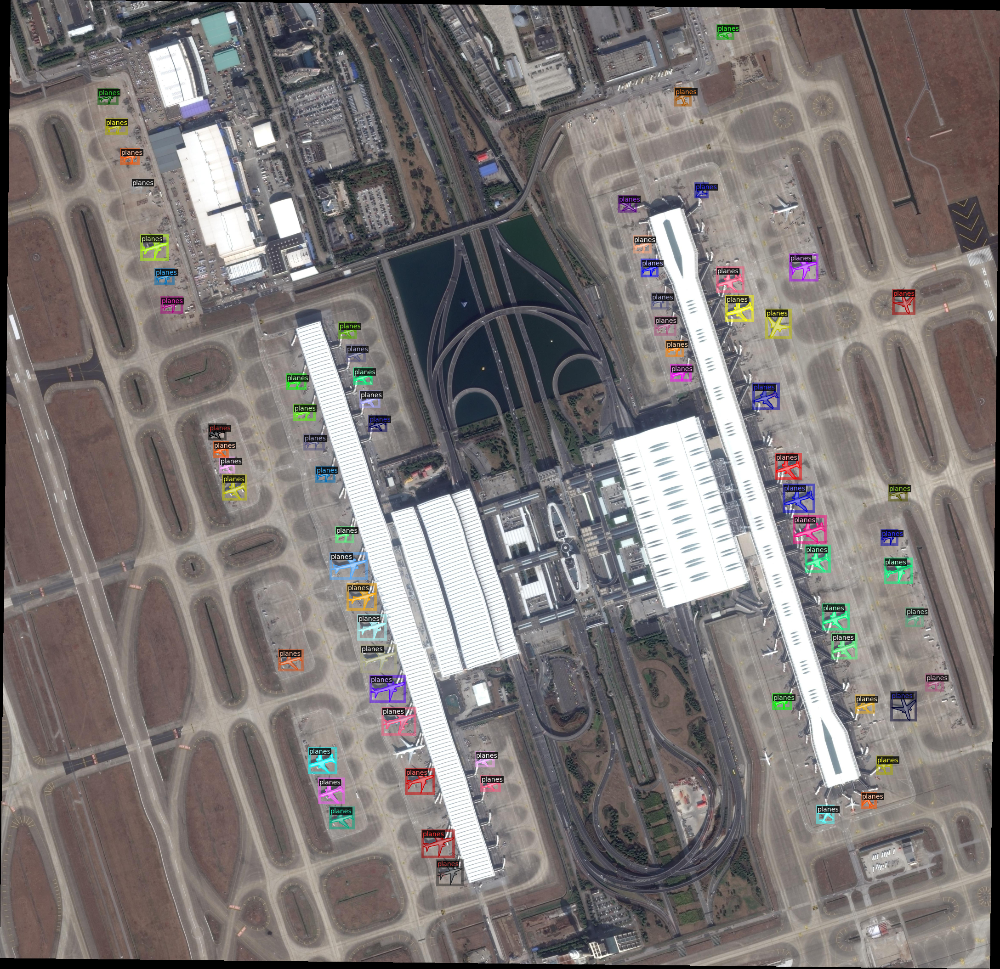

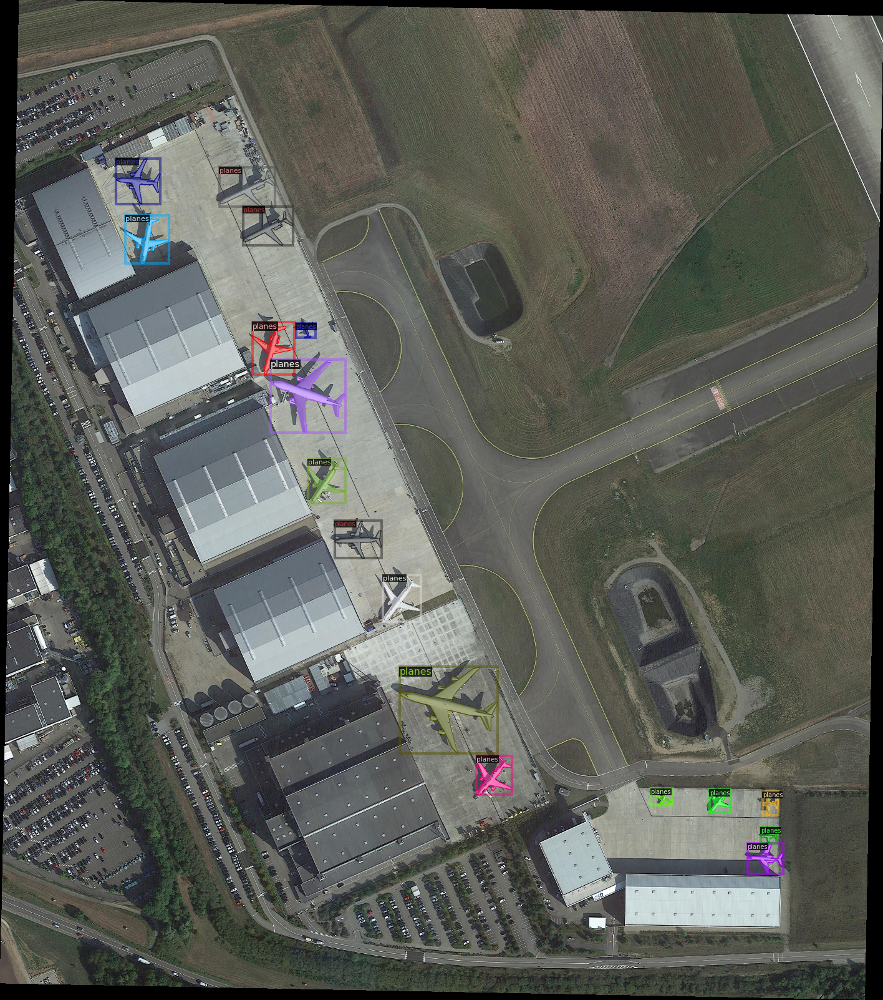

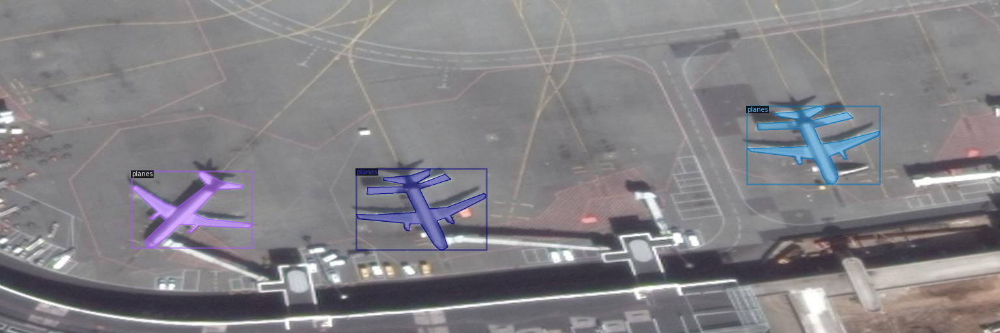

In [ ]:
'''
# Visualize some samples using Visualizer to make sure that the function works correctly
'''

# dataset_dicts = get_detection_data("valid.json")
dataset_dicts = get_detection_data("train.json")
for d in random.sample(dataset_dicts, 3):
    image = cv2.imread(d["file_name"])
    # print(d["file_name"])
    visualizer = Visualizer(image[:, :, ::-1], metadata=planes_metadata, scale=0.5)
    out = visualizer.draw_dataset_dict(d)
    cv2_imshow(out.get_image()[:, :, ::-1])

### Set Configs

In [ ]:
'''
# Set the configs for the detection part in here.
# TODO: approx 15 lines
'''

from detectron2.engine import DefaultTrainer

cfg = get_cfg()
# cfg.merge_from_file(model_zoo.get_config_file("COCO-Detection/faster_rcnn_X_101_32x8d_FPN_3x.yaml"))
cfg.merge_from_file(model_zoo.get_config_file("COCO-Detection/faster_rcnn_R_101_FPN_3x.yaml"))
cfg.DATASETS.TRAIN = ("data_detection_train",)
cfg.DATASETS.TEST = ()
cfg.DATALOADER.NUM_WORKERS = 2
# cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-Detection/faster_rcnn_X_101_32x8d_FPN_3x.yaml")  # Let training initialize from model zoo
cfg.SOLVER.IMS_PER_BATCH = 2
cfg.SOLVER.BASE_LR = 0.00025
cfg.SOLVER.MAX_ITER = 500
cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 512
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 1
cfg.OUTPUT_DIR = f"{BASE_DIR}/output/"
os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)

### Training

In [ ]:
'''
# Create a DefaultTrainer using the above config and train the model
# TODO: approx 5 lines
'''

trainer = DefaultTrainer(cfg)
trainer.resume_or_load(resume=False)
trainer.train()


[03/01 23:29:58 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

R-101.pkl: 179MB [00:25, 7.10MB/s]                           

[03/01 23:30:32 d2.checkpoint.c2_model_loading]: Renaming Caffe2 weights ......


[03/01 23:30:32 d2.checkpoint.c2_model_loading]: Following weights matched with submodule backbone.bottom_up:
| Names in Model    | Names in Checkpoint       | Shapes                                          |
|:------------------|:--------------------------|:------------------------------------------------|
| res2.0.conv1.*    | res2_0_branch2a_{bn_*,w}  | (64,) (64,) (64,) (64,) (64,64,1,1)             |
| res2.0.conv2.*    | res2_0_branch2b_{bn_*,w}  | (64,) (64,) (64,) (64,) (64,64,3,3)             |
| res2.0.conv3.*    | res2_0_branch2c_{bn_*,w}  | (256,) (256,) (256,) (256,) (256,64,1,1)        |
| res2.0.shortcut.* | res2_0_branch1_{bn_*,w}   | (256,) (256,) (256,) (256,) (256,64,1,1)        |
| res2.1.conv1.*    | res2_1_branch2a_{bn_*,w}  | (64,) (64,) (64,) (64,) (64,256,1,1)            |
| res2.1.conv2.*    | res2_1_branch2b_{bn_*,w}  | (64,) (64,) (64,) (64,) (64,64,3,3)             |
| res2.1.conv3.*    | res2_1_branch2c_{bn_*,w}  | (256,) (256,) (256,) (256,) (256,64,1,1)

backbone.fpn_lateral2.{bias, weight}
backbone.fpn_lateral3.{bias, weight}
backbone.fpn_lateral4.{bias, weight}
backbone.fpn_lateral5.{bias, weight}
backbone.fpn_output2.{bias, weight}
backbone.fpn_output3.{bias, weight}
backbone.fpn_output4.{bias, weight}
backbone.fpn_output5.{bias, weight}
proposal_generator.rpn_head.anchor_deltas.{bias, weight}
proposal_generator.rpn_head.conv.{bias, weight}
proposal_generator.rpn_head.objectness_logits.{bias, weight}
roi_heads.box_head.fc1.{bias, weight}
roi_heads.box_head.fc2.{bias, weight}
roi_heads.box_predictor.bbox_pred.{bias, weight}
roi_heads.box_predictor.cls_score.{bias, weight}
  fc1000.{bias, weight}


[03/01 23:30:35 d2.engine.train_loop]: Starting training from iteration 0


/usr/local/lib/python3.8/dist-packages/torch/_tensor.py:575: UserWarning: floor_divide is deprecated, and will be removed in a future version of pytorch. It currently rounds toward 0 (like the 'trunc' function NOT 'floor'). This results in incorrect rounding for negative values.
To keep the current behavior, use torch.div(a, b, rounding_mode='trunc'), or for actual floor division, use torch.div(a, b, rounding_mode='floor'). (Triggered internally at  /pytorch/aten/src/ATen/native/BinaryOps.cpp:467.)
  return torch.floor_divide(self, other)
/usr/local/lib/python3.8/dist-packages/torch/nn/functional.py:718: UserWarning: Named tensors and all their associated APIs are an experimental feature and subject to change. Please do not use them for anything important until they are released as stable. (Triggered internally at  /pytorch/c10/core/TensorImpl.h:1156.)
  return torch.max_pool2d(input, kernel_size, stride, padding, dilation, ceil_mode)


[03/01 23:31:26 d2.utils.events]:  eta: 0:16:45  iter: 19  total_loss: 2.253  loss_cls: 0.4503  loss_box_reg: 0.03019  loss_rpn_cls: 0.7013  loss_rpn_loc: 1.016  time: 2.4070  data_time: 1.7836  lr: 3.8962e-05  max_mem: 3843M
[03/01 23:32:04 d2.utils.events]:  eta: 0:14:43  iter: 39  total_loss: 1.781  loss_cls: 0.2971  loss_box_reg: 0.01191  loss_rpn_cls: 0.6869  loss_rpn_loc: 0.7355  time: 2.1438  data_time: 1.2110  lr: 7.8922e-05  max_mem: 3843M
[03/01 23:32:47 d2.utils.events]:  eta: 0:12:50  iter: 59  total_loss: 1.488  loss_cls: 0.155  loss_box_reg: 0.006117  loss_rpn_cls: 0.644  loss_rpn_loc: 0.5504  time: 2.1423  data_time: 1.4864  lr: 0.00011888  max_mem: 4179M
[03/01 23:33:34 d2.utils.events]:  eta: 0:12:18  iter: 79  total_loss: 1.274  loss_cls: 0.1866  loss_box_reg: 0.02234  loss_rpn_cls: 0.6084  loss_rpn_loc: 0.4529  time: 2.1979  data_time: 1.6688  lr: 0.00015884  max_mem: 4179M
[03/01 23:34:18 d2.utils.events]:  eta: 0:12:04  iter: 99  total_loss: 1.329  loss_cls: 0.1714

### Evaluation and Visualization

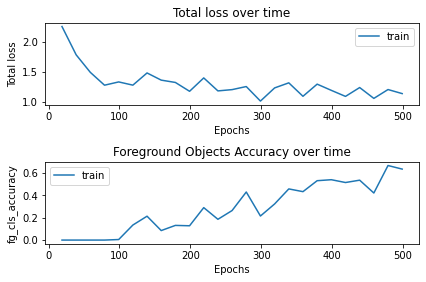

In [ ]:
'''
# Visualize and plot the accuracy and total loss of training model
'''
import pandas as pd
import matplotlib.pyplot as plt

metric_dirs = f'{BASE_DIR}/output/metrics.json'
metrics_df = pd.read_json(metric_dirs, orient="records", lines=True)
mdf = metrics_df.sort_values("iteration")
mdf.head(10).T
fig, ax = plt.subplots(2)

# Total loss plot
mdf1 = mdf[~mdf["total_loss"].isna()]
mdf2 = mdf1
ax[0].plot(mdf1["iteration"], mdf1["total_loss"], c="C0", label="train")
ax[0].legend()
ax[0].set_title("Total loss over time")
ax[0].set_xlabel("Epochs")
ax[0].set_ylabel("Total loss")

# Accuracy plot
ax[1].plot(mdf2["iteration"], mdf2["fast_rcnn/fg_cls_accuracy"], c="C0", label="train")
ax[1].legend()
ax[1].set_title("Foreground Objects Accuracy over time")
ax[1].set_xlabel("Epochs")
ax[1].set_ylabel("fg_cls_accuracy")

fig.tight_layout(pad=1.0)

In [ ]:
'''
# After training the model, you need to update cfg.MODEL.WEIGHTS
# Define a DefaultPredictor
'''

cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.6
predictor = DefaultPredictor(cfg)

  0%|          | 0/72 [00:00<?, ?it/s]

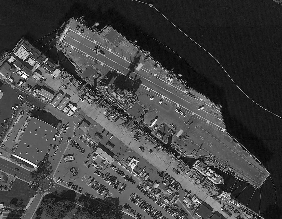

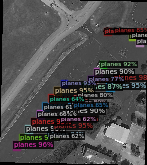

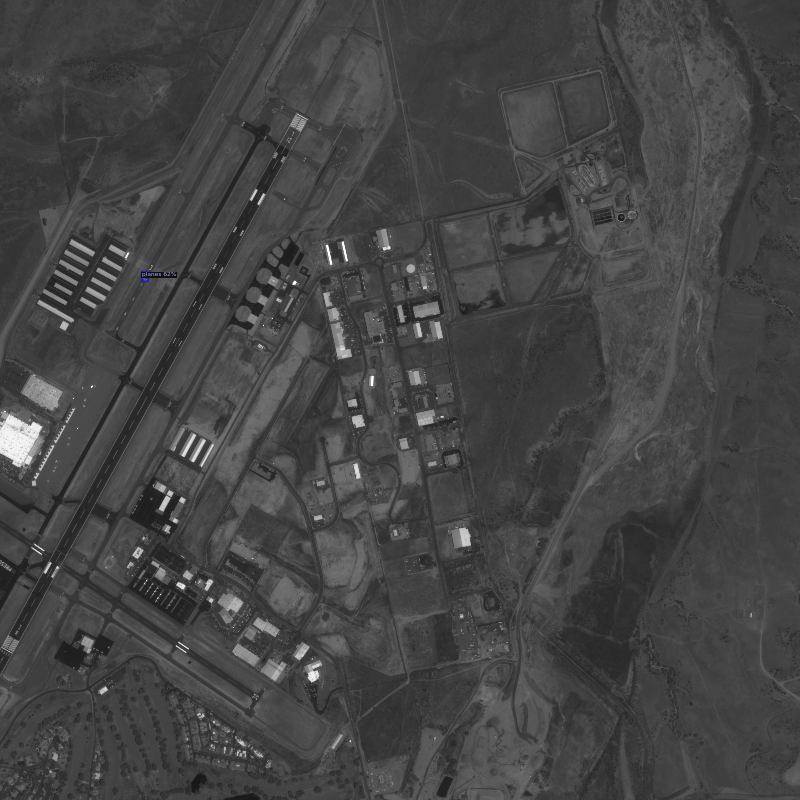

In [ ]:
'''
# Visualize the output for 3 random test samples
# TODO: approx 10 lines
'''
from glob import glob
dataset_dicts = get_detection_data("test.json")
for index in random.sample(dataset_dicts, 3):
    img = cv2.imread(index["file_name"])
    opt = predictor(img)
    visual = Visualizer(img[:, :, ::-1],
                   metadata=planes_metadata,
                   scale=0.2,
                   instance_mode=ColorMode.IMAGE_BW
    )
    out = visual.draw_instance_predictions(opt["instances"].to("cpu"))
    cv2_imshow(out.get_image()[:, :, ::-1])

In [ ]:
'''
# Use COCOEvaluator and build_detection_train_loader
# You can save the output predictions using inference_on_dataset
# TODO: approx 5 lines
'''

from detectron2.evaluation import COCOEvaluator, inference_on_dataset
from detectron2.data import build_detection_test_loader
evaluator = COCOEvaluator("data_detection_val", cfg, False, output_dir=cfg.OUTPUT_DIR)
val_loader = build_detection_test_loader(cfg, "data_detection_val")
print(inference_on_dataset(trainer.model, val_loader, evaluator))

WARNING [03/01 23:49:51 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass in explicit arguments instead.
[03/01 23:49:51 d2.evaluation.coco_evaluation]: Trying to convert 'data_detection_valid' to COCO format ...
[03/01 23:49:51 d2.data.datasets.coco]: Converting annotations of dataset 'data_detection_valid' to COCO format ...)
[03/01 23:49:51 d2.data.datasets.coco]: Converting dataset dicts into COCO format
[03/01 23:49:51 d2.data.datasets.coco]: Conversion finished, #images: 35, #annotations: 1137
[03/01 23:49:51 d2.data.datasets.coco]: Caching COCO format annotations at '/content/drive/My Drive/CMPT_CV_lab3/output/data_detection_valid_coco_format.json' ...
[03/01 23:49:56 d2.data.build]: Distribution of instances among all 1 categories:
|  category  | #instances   |
|:----------:|:-------------|
|   planes   | 1137         |
|            |              |
[03/01 23:49:56 d2.data.dataset_mapper]: [DatasetMapper] Augmenta

### Improvements

In [ ]:
'''
# Bring any changes and updates regarding the improvement in here
'''
from detectron2.engine import DefaultTrainer

cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-Detection/faster_rcnn_X_101_32x8d_FPN_3x.yaml"))
# cfg.merge_from_file(model_zoo.get_config_file("COCO-Detection/faster_rcnn_R_101_FPN_3x.yaml"))
cfg.DATASETS.TRAIN = ("data_detection_train",)
cfg.DATASETS.TEST = ()
cfg.DATALOADER.NUM_WORKERS = 2
# cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-Detection/faster_rcnn_X_101_32x8d_FPN_3x.yaml")  # Training initialize from model zoo
cfg.SOLVER.IMS_PER_BATCH = 2
cfg.SOLVER.BASE_LR = 0.00025  # pick a good LR
cfg.SOLVER.MAX_ITER = 5000  # 300 iterations seems good enough for this toy dataset; need to train longer for a practical dataset
cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 768   # faster, and good enough for this toy dataset (default: 512)
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 1  # only has one class (ballon). (see https://detectron2.readthedocs.io/tutorials/datasets.html#update-the-config-for-new-datasets)
cfg.OUTPUT_DIR = f"{BASE_DIR}/output/"
os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)


## Part 2: Semantic Segmentation

### Data Loader

In [ ]:
'''
# A function that returns the cropped image and corresponding masked regarding the target bounding box
# index is the index of the target bbox in the data
# high-resolution image could be passed or could be load from data['file_name']
# Can use the masked attribute of detectron2.utils.visualizer.GenericMask
#     to convert the segmentation annotations to binary masks
'''

def get_instance_sample(data, idx, image=None):
  filename = data['file_name']
  image = cv2.imread(filename)

  dic = {'image': [], 'masked':[]}

  for index in range(len(data['annotations'])):
      annos = data['annotations'][index]
      bbox = annos['bbox']
      sx,sy,ex,ey = [int(i) for i in bbox]
      obj_img = image[sy:ey, sx:ex]
      segs = annos['segmentation'][0]
      obj_mask = detectron2.utils.visualizer.GenericMask(data["annotations"][index]["segmentation"], data['height'], data['width']).masked
      obj_mask = obj_mask[sy:ey, sx:ex]*255
      obj_img = cv2.resize(obj_img, (128, 128), interpolation = cv2.INTER_AREA)
      obj_mask = cv2.resize(obj_mask, (128, 128), interpolation = cv2.INTER_AREA)
      dic['image'].append(obj_img)
      dic['masked'].append(obj_mask)
  return dic

In [ ]:
data_img = get_detection_data('train.json')
data = {'image': [], 'masked': []}
for i in tqdm(data_img):
    filename = i['file_name'].split('/')[-1].split()

m = get_detection_data('train.json')
data = {'image':[], 'masks':[]}
for i in tqdm(m):
    fname = i["file_name"].split('/')[-1].split('.')[0]
    dic = get_instance_sample(i)
    data['image']+=[dic['image']]
    data['masks']+=[dic['masked']]

  0%|          | 0/198 [00:00<?, ?it/s]

  0%|          | 0/198 [00:00<?, ?it/s]

In [ ]:
'''
# a template data loader for egmentation training
# need to complete the __getitem__() function before running the code
# add data augmentation or normalization in here
'''

class PlaneDataset(Dataset):
  def __init__(self, set_name, data_list):
      self.transforms = transforms.Compose([
          transforms.ToTensor(),
      ])
      self.set_name = set_name
      self.data = data_list
      self.instance_map = []
      for i, d in enumerate(self.data):
        for j in range(len(d['annotations'])):
          self.instance_map.append([i,j])


  '''
  # can change the value of length to a small number like 10 for debugging of your training procedure and overfeating
  # make sure to use the correct length for the final training
  '''
  def __len__(self):
      return len(self.instance_map)

  def numpy_to_tensor(self, image, masked):
    if self.transforms is not None:
        image = self.transforms(image)
        masked = self.transforms(masked)
    image = torch.as_tensor(image, dtype=torch.float)
    masked = torch.as_tensor(masked, dtype=torch.float)
    return image, masked

  '''
  # Complete this part by using get_instance_sample function
  # make sure to resize the image and masked to a fixed size (for example 128*128)
  # can use "interpolate" function of pytorch or "numpy.resize"
  '''
  def __getitem__(self, index):
    if torch.is_tensor(index):
        index = index.tolist()
    index = self.instance_map[index]
    obj_mask = data['masks'][index[0]][index[1]]
    obj_img = data['image'][index[0]][index[1]]
    image, masked = self.numpy_to_tensor(obj_img, obj_mask)
    return image, masked

def get_plane_dataset(set_name='train', batch_size=2):
    my_data_list = DatasetCatalog.get("data_detection_{}".format(set_name))
    dataset = PlaneDataset(set_name, my_data_list)
    loader = DataLoader(dataset, batch_size=batch_size, num_workers=4,
                                              pin_memory=True, shuffle=True)
    return loader, dataset

### Network

In [ ]:
'''
# convolution module as a template layer consists of conv2d layer, batch normalization, and relu activation
'''

class conv(nn.Module):
    def __init__(self, in_ch, out_ch, activation=True):
        super(conv, self).__init__()
        if(activation):
          self.layer = nn.Sequential(
             nn.Conv2d(in_ch, out_ch, 3, padding=1),
             nn.BatchNorm2d(out_ch),
             nn.ReLU(inplace=True)
          )
        else:
          self.layer = nn.Sequential(
             nn.Conv2d(in_ch, out_ch, 3, padding=1)  ,
             )

    def forward(self, x):
        x = self.layer(x)
        return x


'''
# downsampling module equal to a conv module followed by a max-pool layer
'''
class down(nn.Module):
    def __init__(self, in_ch, out_ch):
        super(down, self).__init__()
        self.layer = nn.Sequential(
            conv(in_ch, out_ch),
            nn.MaxPool2d(2)
            )

    def forward(self, x):
        x = self.layer(x)
        return x

'''
# upsampling module equal to a upsample function followed by a conv module
'''
class up(nn.Module):
    def __init__(self, in_ch, out_ch, bilinear=False):
        super(up, self).__init__()
        if bilinear:
            self.up = nn.Upsample(scale_factor=2, mode='bilinear', align_corners=True)
        else:
            self.up = nn.ConvTranspose2d(in_ch, in_ch, 2, stride=2)

        self.conv = conv(in_ch, out_ch)

    def forward(self, x):
        y = self.up(x)
        y = self.conv(y)
        return y

'''
# the main model complete by using above modules.
'''
class MyModel(nn.Module):
    def __init__(self):
        super(MyModel, self).__init__()

        # Encoder

        self.input_conv = conv(3, 8)
        self.down_1 = down(8, 16)
        self.down_2 = down(16, 32)
        self.down_3 = down(32, 64)
        self.down_4 = down(64, 128)
        self.down_5 = down(128, 256)
        self.down_6 = down(256, 512)

        # Decoder

        self.up_1 = up(512, 256)
        self.up_2 = up(256, 128)
        self.up_3 = up(128, 64)
        self.up_4 = up(64, 32)
        self.up_5 = up(32, 16)
        self.up_6 = up(16, 8)
        self.up_7 = conv(8, 3)
        self.output_conv = conv(3, 1, False) # ReLu activation is removed to keep the logits for the loss function

        self.skip_1 = nn.BatchNorm2d(8)
        self.skip_2 = nn.BatchNorm2d(16)
        self.skip_3 = nn.BatchNorm2d(32)
        self.skip_4 = nn.BatchNorm2d(64)
        self.skip_5 = nn.BatchNorm2d(128)
        self.skip_6 = nn.BatchNorm2d(256)

    def forward(self, input):
      y_1 = self.input_conv(input)
      y_2 = self.down_1(y_1)
      y_3 = self.down_2(y_2)
      y_4 = self.down_3(y_3)
      y_5 = self.down_4(y_4)
      y_6 = self.down_5(y_5)
      y_7 = self.down_6(y_6)
      y_7 = self.skip_6(F.relu(self.up_1(y_7) + y_6))
      y_6 = self.skip_5(F.relu(self.up_2(y_7) + y_5))
      y_5 = self.skip_4(F.relu(self.up_3(y_6) + y_4))
      y_4 = self.skip_3(F.relu(self.up_4(y_5) + y_3))
      y_3 = self.skip_2(F.relu(self.up_5(y_4) + y_2))
      y_2 = self.skip_1(F.relu(self.up_6(y_3) + y_1))
      y = self.up_7(y_2)
      output = self.output_conv(y)
      return output

In [ ]:
'''
# network summary
'''
from torchsummary import summary
model = MyModel().cuda()
summary(model, (3,128, 128))

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1          [-1, 8, 128, 128]             224
       BatchNorm2d-2          [-1, 8, 128, 128]              16
              ReLU-3          [-1, 8, 128, 128]               0
              conv-4          [-1, 8, 128, 128]               0
            Conv2d-5         [-1, 16, 128, 128]           1,168
       BatchNorm2d-6         [-1, 16, 128, 128]              32
              ReLU-7         [-1, 16, 128, 128]               0
              conv-8         [-1, 16, 128, 128]               0
         MaxPool2d-9           [-1, 16, 64, 64]               0
             down-10           [-1, 16, 64, 64]               0
           Conv2d-11           [-1, 32, 64, 64]           4,640
      BatchNorm2d-12           [-1, 32, 64, 64]              64
             ReLU-13           [-1, 32, 64, 64]               0
             conv-14           [-1, 32,

### Training

In [ ]:
'''
# basic training procedure to train the network
'''

# Set the hyperparameters
num_epochs = 40
batch_size = 32
learning_rate = 1e-1
weight_decay = 1e-5

model = MyModel()
model = model.cuda()
loader, _ = get_plane_dataset('train', batch_size)
logit_loss = nn.BCEWithLogitsLoss()
optimizer = torch.optim.SGD(model.parameters(), lr=learning_rate, weight_decay=weight_decay)
i=1

for epoch in tqdm(range(num_epochs)):
  total_loss = 0
  if i % 15 == 0 and i > 16:
    for param_group in optimizer.param_groups:
      param_group['lr'] /=10
  for (image, masked) in tqdm(loader):
    image = torch.tensor(image, device=torch.device('cuda'), requires_grad = True)
    masked = torch.tensor(masked, device=torch.device('cuda'), requires_grad = True)
    pred = model(image)
    loss = logit_loss(pred, masked)
    optimizer.zero_grad()
    loss.backward()
    optimizer.step()
    total_loss += loss.cpu().data
  print("Epoch: {}, Loss: {}".format(epoch, total_loss/len(loader)))
  i+=1

# Save model
torch.save(model.state_dict(), '{}/output/final_segmentation_model.pth'.format(BASE_DIR))


/usr/local/lib/python3.8/dist-packages/torch/utils/data/dataloader.py:478: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(_create_warning_msg(


  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/250 [00:00<?, ?it/s]

<ipython-input-19-e95a7b4d743d>:26: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  img = torch.tensor(img, device=torch.device('cuda'), requires_grad = True)
<ipython-input-19-e95a7b4d743d>:27: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  mask = torch.tensor(mask, device=torch.device('cuda'), requires_grad = True)


Epoch: 0, Loss: 0.2810496687889099


  0%|          | 0/250 [00:00<?, ?it/s]

Epoch: 1, Loss: 0.2026592493057251


  0%|          | 0/250 [00:00<?, ?it/s]

Epoch: 2, Loss: 0.18582549691200256


  0%|          | 0/250 [00:00<?, ?it/s]

Epoch: 3, Loss: 0.17335760593414307


  0%|          | 0/250 [00:00<?, ?it/s]

Epoch: 4, Loss: 0.165938138961792


  0%|          | 0/250 [00:00<?, ?it/s]

Epoch: 5, Loss: 0.15925350785255432


  0%|          | 0/250 [00:00<?, ?it/s]

Epoch: 6, Loss: 0.15162642300128937


  0%|          | 0/250 [00:00<?, ?it/s]

Epoch: 7, Loss: 0.14542989432811737


  0%|          | 0/250 [00:00<?, ?it/s]

Epoch: 8, Loss: 0.14038297533988953


  0%|          | 0/250 [00:00<?, ?it/s]

Epoch: 9, Loss: 0.13512684404850006


  0%|          | 0/250 [00:00<?, ?it/s]

Epoch: 10, Loss: 0.13045638799667358


  0%|          | 0/250 [00:00<?, ?it/s]

Epoch: 11, Loss: 0.12708041071891785


  0%|          | 0/250 [00:00<?, ?it/s]

Epoch: 12, Loss: 0.1225617378950119


  0%|          | 0/250 [00:00<?, ?it/s]

Epoch: 13, Loss: 0.11894100904464722


  0%|          | 0/250 [00:00<?, ?it/s]

Epoch: 14, Loss: 0.11604214459657669


  0%|          | 0/250 [00:00<?, ?it/s]

Epoch: 15, Loss: 0.11354715377092361


  0%|          | 0/250 [00:00<?, ?it/s]

Epoch: 16, Loss: 0.11100510507822037


  0%|          | 0/250 [00:00<?, ?it/s]

Epoch: 17, Loss: 0.10746423900127411


  0%|          | 0/250 [00:00<?, ?it/s]

Epoch: 18, Loss: 0.10443613678216934


  0%|          | 0/250 [00:00<?, ?it/s]

Epoch: 19, Loss: 0.10360077768564224


  0%|          | 0/250 [00:00<?, ?it/s]

Epoch: 20, Loss: 0.09968399256467819


  0%|          | 0/250 [00:00<?, ?it/s]

Epoch: 21, Loss: 0.09806980192661285


  0%|          | 0/250 [00:00<?, ?it/s]

Epoch: 22, Loss: 0.09677428752183914


  0%|          | 0/250 [00:00<?, ?it/s]

Epoch: 23, Loss: 0.09509009122848511


  0%|          | 0/250 [00:00<?, ?it/s]

Epoch: 24, Loss: 0.09345822036266327


  0%|          | 0/250 [00:00<?, ?it/s]

Epoch: 25, Loss: 0.09084899723529816


  0%|          | 0/250 [00:00<?, ?it/s]

Epoch: 26, Loss: 0.08952682465314865


  0%|          | 0/250 [00:00<?, ?it/s]

Epoch: 27, Loss: 0.08882781118154526


  0%|          | 0/250 [00:00<?, ?it/s]

Epoch: 28, Loss: 0.08687738329172134


  0%|          | 0/250 [00:00<?, ?it/s]

Epoch: 29, Loss: 0.07890280336141586


  0%|          | 0/250 [00:00<?, ?it/s]

Epoch: 30, Loss: 0.07630138099193573


  0%|          | 0/250 [00:00<?, ?it/s]

Epoch: 31, Loss: 0.07559321075677872


  0%|          | 0/250 [00:00<?, ?it/s]

Epoch: 32, Loss: 0.07487662136554718


  0%|          | 0/250 [00:00<?, ?it/s]

Epoch: 33, Loss: 0.07397035509347916


  0%|          | 0/250 [00:00<?, ?it/s]

Epoch: 34, Loss: 0.07384166866540909


  0%|          | 0/250 [00:00<?, ?it/s]

Epoch: 35, Loss: 0.07310324162244797


  0%|          | 0/250 [00:00<?, ?it/s]

Epoch: 36, Loss: 0.07299558073282242


  0%|          | 0/250 [00:00<?, ?it/s]

Epoch: 37, Loss: 0.0725119560956955


  0%|          | 0/250 [00:00<?, ?it/s]

Epoch: 38, Loss: 0.0721280500292778


  0%|          | 0/250 [00:00<?, ?it/s]

Epoch: 39, Loss: 0.07193246483802795


### Evaluation and Visualization

In [ ]:
'''
# Before starting the evaluation, need to set the model mode to eval
# may load the trained model again, in case want to continue your code late
'''
batch_size = 1
model = MyModel().cuda()
model.load_state_dict(torch.load('{}/output/final_segmentation_model.pth'.format(BASE_DIR)))
model = model.eval() # chaning the model to evaluation mode will fix the bachnorm layers
loader, dataset = get_plane_dataset('train', batch_size)

def sigmoid(x):
  return 1/(1 + np.exp(-x))

def iou_coef(y_true, y_pred):
  y_true = np.rint(sigmoid(y_true))
  y_pred = np.rint(sigmoid(y_pred))
  intersection = np.count_nonzero(np.multiply(y_true, y_pred))
  union = np.count_nonzero(y_true+y_pred)
  if union == 0:
      return 0
  return intersection/union


total_iou = 0
count = 0
for (image, masked) in tqdm(loader):
  with torch.no_grad():
    image = image.cuda()
    masked = masked.cpu().detach()
    pred = model(image).cpu().detach()
    for i in range(image.shape[0]):
        predicted = np.array(pred[i])[0]
        masked = np.array(masked[i])[0]
        count+=1
        total_iou+=iou_coef(masked, predicted)
  '''
  ## Complete the code by obtaining the IoU for each image and print the final Mean IoU
  '''


print("\n #images: {}, Mean IoU: {}".format(count, total_iou/count))

  0%|          | 0/7980 [00:00<?, ?it/s]


 #images: 7980, Mean IoU: 0.8994745368071959


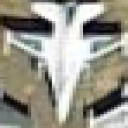

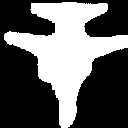

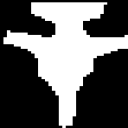

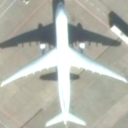

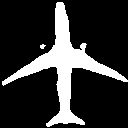

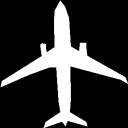

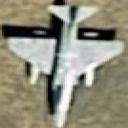

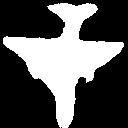

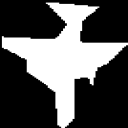

In [ ]:
'''
# Visualize 3 sample output
'''
batch_size = 3
loader, dataset = get_plane_dataset('train', batch_size)

image, masked = next(iter(loader))
with torch.no_grad():
    image = image.cuda()
    masked = masked.cpu().detach()
    pred = model(image).cpu().detach()
    for i in range(image.shape[0]):
        newimg = transforms.ToPILImage()(image[i].cpu())
        cv2_imshow(np.array(newimg))
        predicted = np.rint(sigmoid(np.array(pred[i])[0]))*255
        masked = np.array(masked[i])[0]*255
        cv2_imshow(predicted)
        cv2_imshow(masked)

## Part 3: Instance Segmentation

In this part, I obtain the instance segmentation results for the test data by using the trained segmentation model in the previous part and the detection model in Part 1.

### Get Prediction

In [ ]:
'''
# Define a new function to obtain the prediction masked by passing a sample data
# For this part, I use all the previous parts (predictor, get_instance_sample, data preprocessings, etc)
# It is better to keep everything (as well as the output of this funcion) on gpu as tensors to speed up the operations.
# pred_mask is the instance segmentation result and should have different values for different planes.
'''
dataset[0]['annotations'][0]['bbox']

model = MyModel().cuda()
model.load_state_dict(torch.load('{}/output/final_segmentation_model.pth'.format(BASE_DIR)))

def sigmoid(x):
  return 1/(1 + np.exp(-x))

def get_prediction_mask(my_data, train=False):
  image = cv2.imread(my_data['file_name'])
  if train:
      pred_masks = np.zeros([my_data['height'], my_data['width']])
      imgs = []

      for i,j in enumerate(my_data['annotations']):
          bbox = j['bbox']
          y1, x1, y2, x2 = bbox
          to_mask = image[x1:x2, y1:y2]
          to_mask = cv2.resize(to_mask, (128, 128), interpolation = cv2.INTER_AREA)
          mask_pred = model(torch.unsqueeze(torch.tensor(transforms.ToTensor()(to_mask), device=torch.device('cuda')),0)).cpu().detach().numpy()[0] # Getting a masked prediction from my trained model
          mask_pred = cv2.resize(mask_pred[0], (y2-y1, x2-x1), interpolation = cv2.INTER_AREA) # Reshaping to the original shape
          mask_pred = np.rint(sigmoid(mask_pred))*(i+1)
          predicted_mask = pred_masks[x1:x2, y1:y2]
          predicted_mask[predicted_mask==0] = 10000
          overlapping = np.minimum(predicted_mask,mask_pred)
          overlapping[overlapping == 1000] = 0
          pred_masks[x1:x2, y1:y2] = overlapping
  else:
      prediction_for_img = predictor(image)['instances']
      pred_masks = np.zeros([my_data['height'], my_data['width']])
      imgs = []

      for i in range(len(prediction_for_img)):
          bbox = np.array(np.floor(list(prediction_for_img[i]._fields['pred_boxes'])[0].cpu().numpy()), dtype=np.uint32)
          y1, x1, y2, x2 = bbox
          to_mask = image[x1:x2, y1:y2]
          to_mask = cv2.resize(to_mask, (128, 128), interpolation = cv2.INTER_AREA)
          mask_pred = model(torch.unsqueeze(torch.tensor(transforms.ToTensor()(to_mask), device=torch.device('cuda')),0)).cpu().detach().numpy()[0]
          mask_pred = cv2.resize(mask_pred[0], (y2-y1, x2-x1), interpolation = cv2.INTER_AREA)
          mask_pred = np.rint(sigmoid(mask_pred))*(i+1)
          predicted_mask = pred_masks[x1:x2, y1:y2]
          predicted_mask[predicted_mask==0] = 10000
          overlapping = np.minimum(predicted_mask,mask_pred)
          overlapping[overlapping == 1000] = 0
          pred_masks[x1:x2, y1:y2] = overlapping

  result_mask = np.zeros([my_data['height'], my_data['width']])
  for j,i in enumerate(my_data['annotations']):
      bbox = i['bbox']
      y1, x1, y2, x2 = [int(i) for i in bbox]
      x2 +=x1
      y2 += y1
      local_true_mask = detectron2.utils.visualizer.GenericMask(i['segmentation'], my_data['height'], my_data['width']).masked
      overlapping = np.maximum(result_mask[x1:x2, y1:y2],local_true_mask[x1:x2, y1:y2]*(j+1))
      result_mask[x1:x2, y1:y2] = overlapping
  return image, torch.tensor(result_mask, device=torch.device('cuda')), torch.tensor(pred_masks, device=torch.device('cuda'))

### Visualization and Submission

  0%|          | 0/72 [00:00<?, ?it/s]

<ipython-input-22-ec4fd2352764>:51: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  prediction_from_mask = model(torch.unsqueeze(torch.tensor(transforms.ToTensor()(to_be_masked), device=torch.device('cuda')),0)).cpu().detach().numpy()[0] # Getting a mask prediction from my trained model
<ipython-input-30-62a8a3c1d95b>:14: RuntimeWarning: divide by zero encountered in double_scalars
  fact = 255./max_val
<ipython-input-30-62a8a3c1d95b>:15: RuntimeWarning: invalid value encountered in multiply
  true_mask*= fact


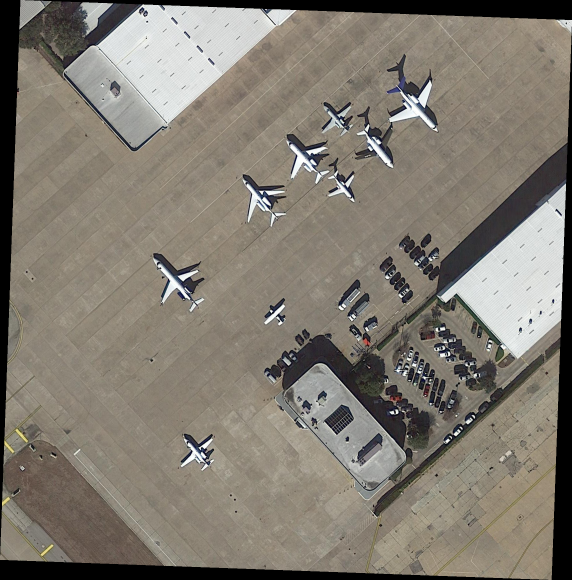

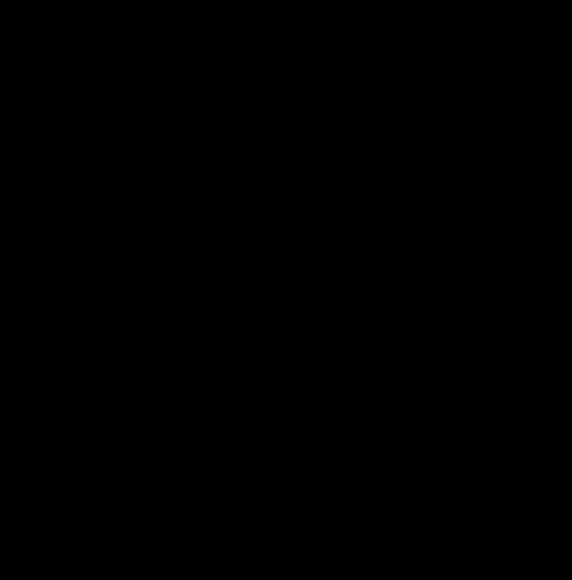

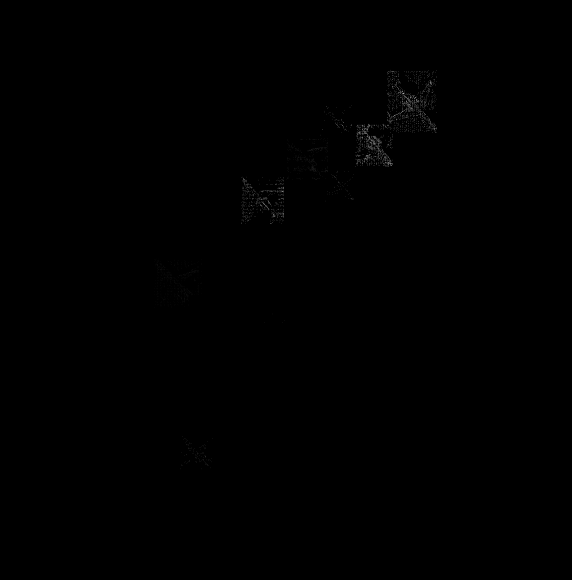

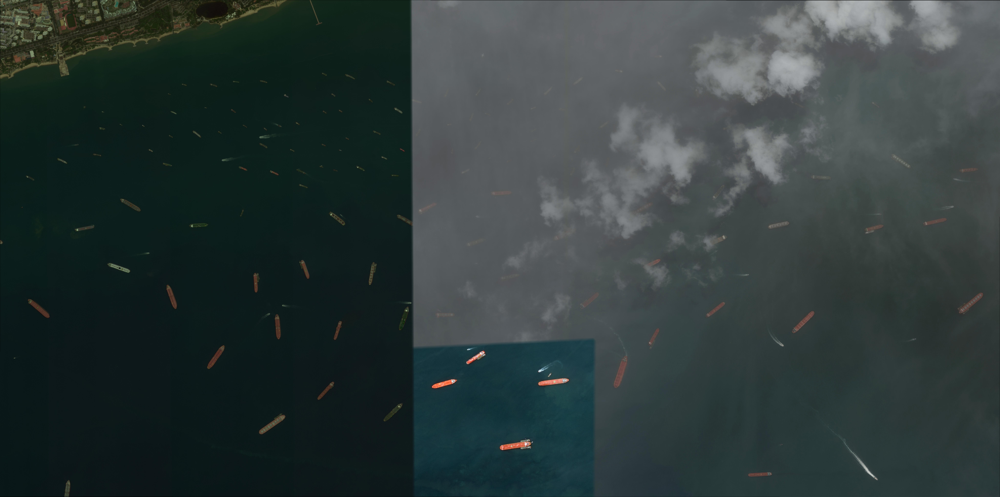

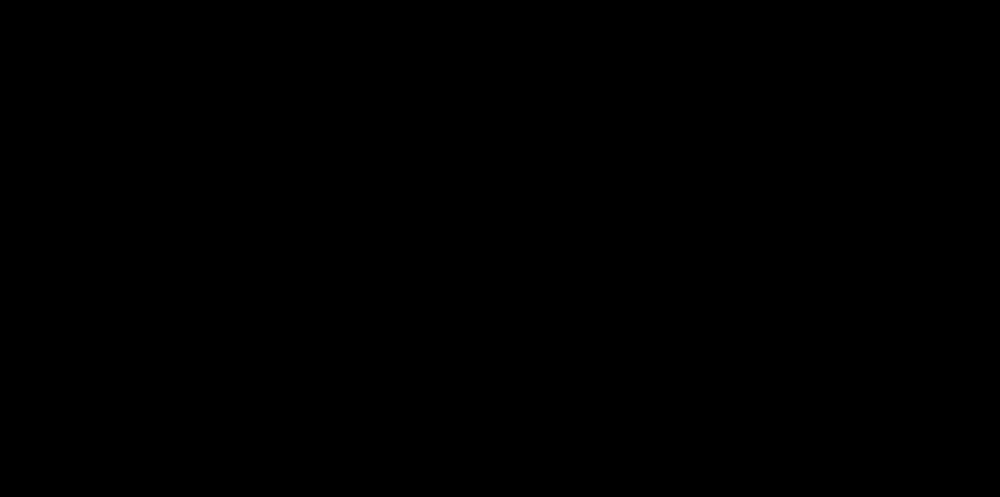

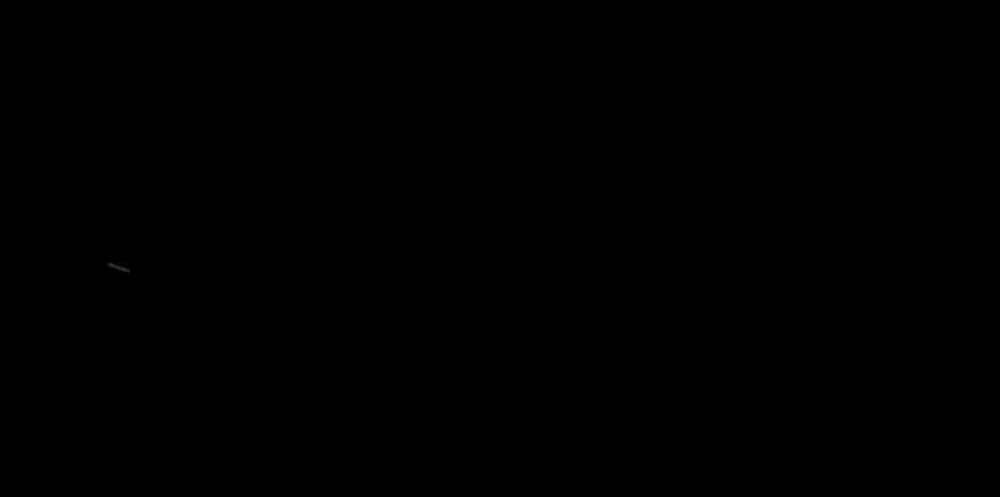

<ipython-input-30-62a8a3c1d95b>:11: RuntimeWarning: divide by zero encountered in double_scalars
  fact = 255./max_val
<ipython-input-30-62a8a3c1d95b>:12: RuntimeWarning: invalid value encountered in multiply
  pred_mask*= fact


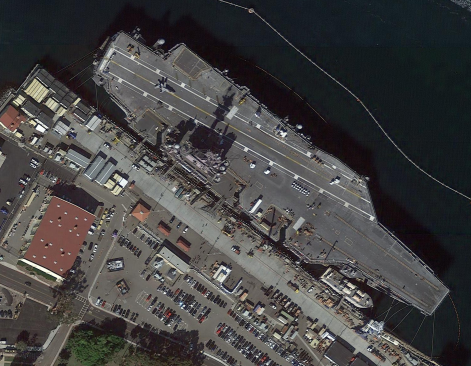

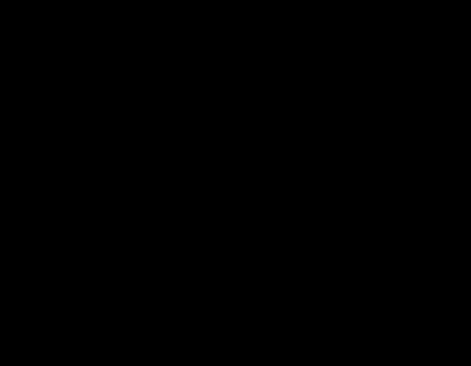

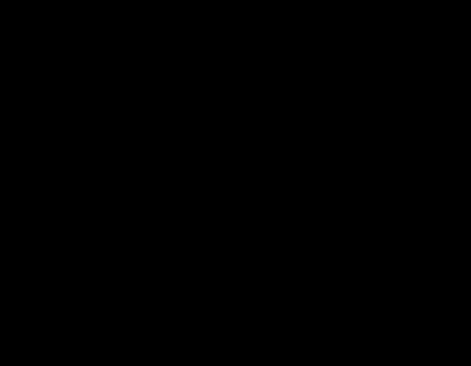

In [ ]:
'''
# Visualise the output prediction as well as the GT Mask and Input image for a sample input
'''
dataset = get_detection_data('test.json')
for i in np.random.randint(0,50,3):
  image, result_mask, pred_mask = get_prediction_mask(dataset[i])
  pred_mask = pred_mask.cpu().numpy()
  result_mask = result_mask.cpu().numpy()
  max_val = pred_mask.max()
  fact = 255./max_val
  pred_mask*= fact
  max_val = result_mask.max()
  fact = 255./max_val
  result_mask*= fact
  cv2_imshow(cv2.resize(image, (image.shape[1]//3, image.shape[0]//3), interpolation = cv2.INTER_AREA))
  cv2_imshow(cv2.resize(result_mask, (result_mask.shape[1]//3, result_mask.shape[0]//3), interpolation = cv2.INTER_AREA))
  cv2_imshow(cv2.resize(pred_mask, (pred_mask.shape[1]//3, pred_mask.shape[0]//3), interpolation = cv2.INTER_AREA))


In [ ]:
'''
# ref: https://www.kaggle.com/rakhlin/fast-run-length-encoding-python
# https://www.kaggle.com/c/airbus-ship-detection/overview/evaluation
'''
def rle_encoding(x):
    '''
    x: pytorch tensor on gpu, 1 - masked, 0 - background
    Returns run length as list
    '''
    dots = torch.where(torch.flatten(x.long())==1)[0]
    if(len(dots)==0):
      return []
    inds = torch.where(dots[1:]!=dots[:-1]+1)[0]+1
    inds = torch.cat((torch.tensor([0], device=torch.device('cuda'), dtype=torch.long), inds))
    tmpdots = dots[inds]
    inds = torch.cat((inds, torch.tensor([len(dots)], device=torch.device('cuda'))))
    inds = inds[1:] - inds[:-1]
    runs = torch.cat((tmpdots, inds)).reshape((2,-1))
    runs = torch.flatten(torch.transpose(runs, 0, 1)).cpu().data.numpy()
    return ' '.join([str(i) for i in runs])

In [ ]:
'''
# upload the csv file on kaggle
# The speed of your code in the previous parts highly affects the running time of this part
'''

preddic = {"ImageId": [], "EncodedPixels": []}

'''
# Writing the predictions of the training set
'''
my_data_list = DatasetCatalog.get("data_detection_{}".format('train'))
for i in tqdm(range(len(my_data_list)), position=0, leave=True):
  sample = my_data_list[i]
  sample['image_id'] = sample['file_name'].split("/")[-1][:-4]
  image, result_mask, pred_mask = get_prediction_mask(sample)
  inds = torch.unique(pred_mask)
  if(len(inds)==1):
    preddic['ImageId'].append(sample['image_id'])
    preddic['EncodedPixels'].append([])
  else:
    for index in inds:
      if(index == 0):
        continue
      tmp_mask = (pred_mask==index)
      encPix = rle_encoding(tmp_mask)
      preddic['ImageId'].append(sample['image_id'])
      preddic['EncodedPixels'].append(encPix)

'''
# Writing the predictions of the test set
'''

my_data_list = DatasetCatalog.get("data_detection_{}".format('test'))
for i in tqdm(range(len(my_data_list)), position=0, leave=True):
  sample = my_data_list[i]
  sample['image_id'] = sample['file_name'].split("/")[-1][:-4]
  image, result_mask, pred_mask = get_prediction_mask(sample)
  inds = torch.unique(pred_mask)
  if(len(inds)==1):
    preddic['ImageId'].append(sample['image_id'])
    preddic['EncodedPixels'].append([])
  else:
    for j, index in enumerate(inds):
      if(index == 0):
        continue
      tmp_mask = (pred_mask==index).double()
      encPix = rle_encoding(tmp_mask)
      preddic['ImageId'].append(sample['image_id'])
      preddic['EncodedPixels'].append(encPix)

pred_file = open("{}/pred.csv".format(BASE_DIR), 'w')
pd.DataFrame(preddic).to_csv(pred_file, index=False)
pred_file.close()


  0%|          | 0/198 [00:00<?, ?it/s]

<ipython-input-22-ec4fd2352764>:51: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  prediction_from_mask = model(torch.unsqueeze(torch.tensor(transforms.ToTensor()(to_be_masked), device=torch.device('cuda')),0)).cpu().detach().numpy()[0] # Getting a mask prediction from my trained model


  0%|          | 0/72 [00:00<?, ?it/s]

  0%|          | 0/72 [00:00<?, ?it/s]

## Part 4: Mask R-CNN

I follow a same procedure to part 2 with the configs of Mask R-CNN, other parts are generally the same as part 2.

### Data Loader

In [ ]:
from detectron2.data import DatasetCatalog
DatasetCatalog.clear() # to clear all of register outputs
MetadataCatalog.clear()

dataset, vals = train('train.json', 10) # for validation

for d in ["train","test","valid"]:
    DatasetCatalog.register("data_detection_" + d, lambda d=d: get_detection_data(d+'.json'))
    MetadataCatalog.get("data_detection_" + d).set(thing_classes=["planes"])
planes_metadata = MetadataCatalog.get("data_detection_train")

  0%|          | 0/7980 [00:00<?, ?it/s]

### Network

In [ ]:
from detectron2.engine import DefaultTrainer

cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml"))
cfg.DATASETS.TRAIN = ("data_detection_train",)
cfg.DATASETS.TEST = ()
cfg.DATALOADER.NUM_WORKERS = 2
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml")
cfg.SOLVER.IMS_PER_BATCH = 2
cfg.SOLVER.BASE_LR = 0.001
cfg.SOLVER.MAX_ITER = 500
cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 512
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 1
cfg.OUTPUT_DIR = f"{BASE_DIR}/output/"
os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)

### Training

In [ ]:
trainer = DefaultTrainer(cfg)
trainer.resume_or_load(resume=False)
trainer.train()
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")  # path to the model we just trained
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.6   # set a custom testing threshold
predictor = DefaultPredictor(cfg)

[03/02 00:38:21 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

model_final_f10217.pkl: 178MB [00:13, 13.6MB/s]                           
roi_heads.box_predictor.bbox_pred.{bias, weight}
roi_heads.box_predictor.cls_score.{bias, weight}
roi_heads.mask_head.predictor.{bias, weight}


[03/02 00:38:35 d2.engine.train_loop]: Starting training from iteration 0
[03/02 00:39:08 d2.utils.events]:  eta: 0:07:57  iter: 19  total_loss: 3.497  loss_cls: 0.6929  loss_box_reg: 0.3699  loss_mask: 0.6985  loss_rpn_cls: 1.338  loss_rpn_loc: 0.4137  time: 1.3971  data_time: 0.9007  lr: 3.8962e-05  max_mem: 6796M
[03/02 00:39:43 d2.utils.events]:  eta: 0:07:37  iter: 39  total_loss: 2.204  loss_cls: 0.488  loss_box_reg: 0.3437  loss_mask: 0.6687  loss_rpn_cls: 0.2726  loss_rpn_loc: 0.3024  time: 1.6002  data_time: 1.0836  lr: 7.8922e-05  max_mem: 6796M
[03/02 00:40:14 d2.utils.events]:  eta: 0:07:19  iter: 59  total_loss: 2.017  loss_cls: 0.3396  loss_box_reg: 0.2466  loss_mask: 0.6136  loss_rpn_cls: 0.2939  loss_rpn_loc: 0.3544  time: 1.5857  data_time: 0.9165  lr: 0.00011888  max_mem: 6796M
[03/02 00:40:42 d2.utils.events]:  eta: 0:07:40  iter: 79  total_loss: 1.929  loss_cls: 0.3635  loss_box_reg: 0.3433  loss_mask: 0.5605  loss_rpn_cls: 0.2646  loss_rpn_loc: 0.3031  time: 1.5335

### Evaluation and Visualization

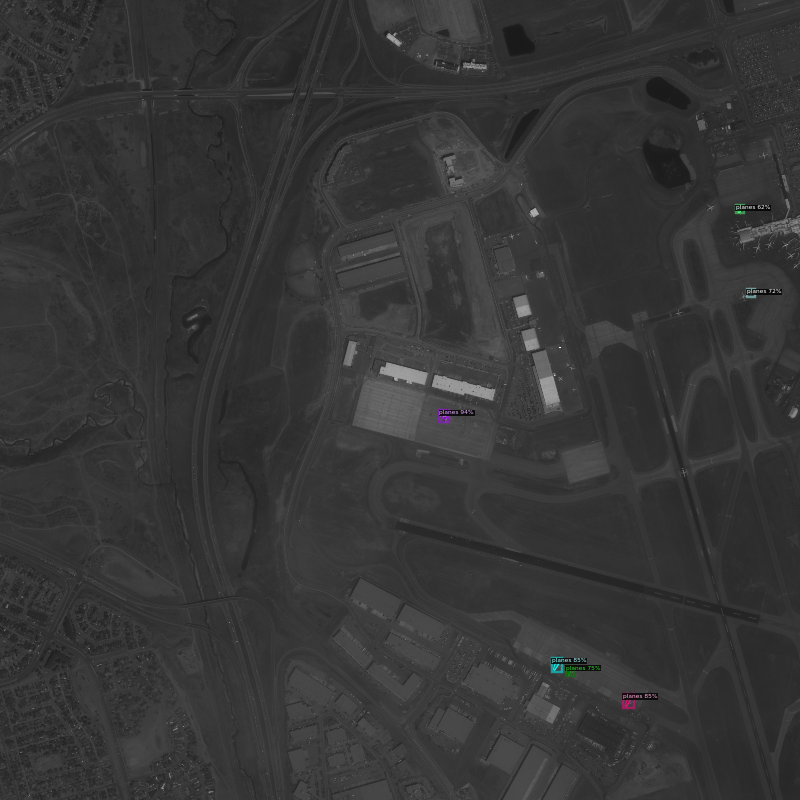

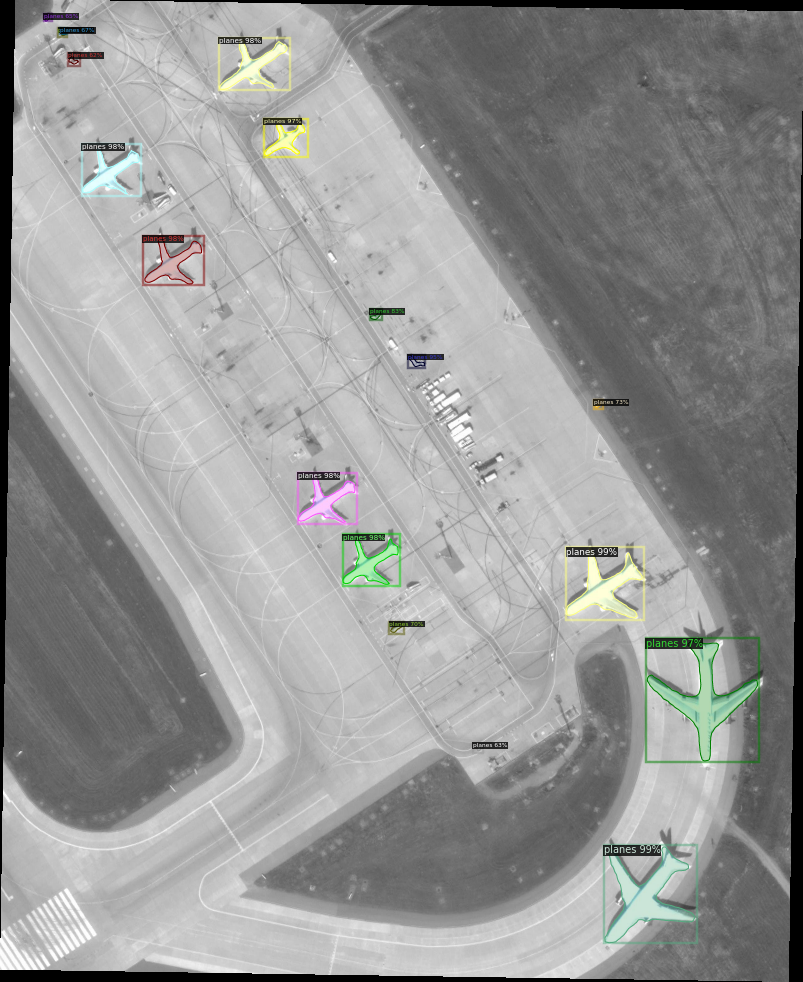

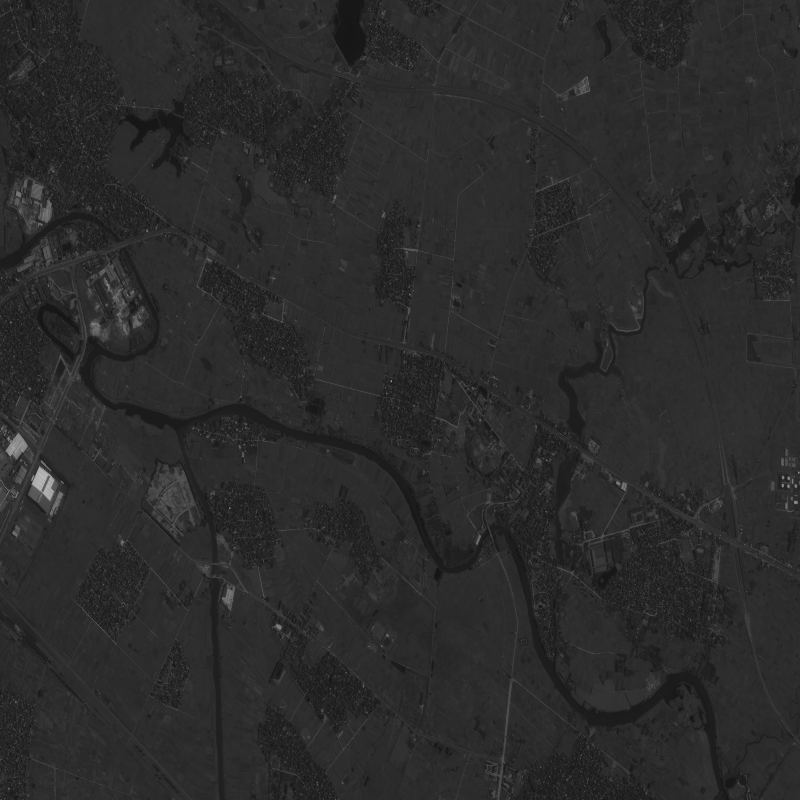

In [ ]:
from detectron2.utils.visualizer import ColorMode
dataset_dicts = get_detection_data("valid.json")
for d in random.sample(dataset_dicts, 3):
    im = cv2.imread(d["file_name"])
    outputs = predictor(im)  # format is documented at https://detectron2.readthedocs.io/tutorials/models.html#model-output-format
    v = Visualizer(im[:, :, ::-1],
                   metadata=planes_metadata,
                   scale=0.2,
                   instance_mode=ColorMode.IMAGE_BW   # remove the colors of unsegmented pixels. This option is only available for segmentation models
    )
    out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
    cv2_imshow(out.get_image()[:, :, ::-1])


In [ ]:
from detectron2.evaluation import COCOEvaluator, inference_on_dataset
from detectron2.data import build_detection_test_loader
evaluator = COCOEvaluator("data_detection_valid", cfg, False, output_dir=cfg.OUTPUT_DIR)
val_loader = build_detection_test_loader(cfg, "data_detection_valid")
print(inference_on_dataset(trainer.model, val_loader, evaluator))